In [1]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2
import glob
import os
%matplotlib inline

# Part 1 - Camera Calibration

In [2]:
from calibration_utils import camera_calibration
from calibration_utils import undistorted_images
from calibration_utils import warped_image

In [3]:
# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')
# make a direction to store the images if outpur_images/ is not exist
out_cal_images_path = 'output_images/'
os.makedirs(os.path.dirname('output_images/'), exist_ok=True)

## 1. Draw chessboard corners and apply calibration

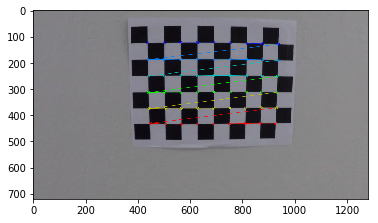

In [4]:
ret, mtx, dist, rvecs, tvecs = camera_calibration(images=images, nx=9, ny=6)

## 2. Undistortion

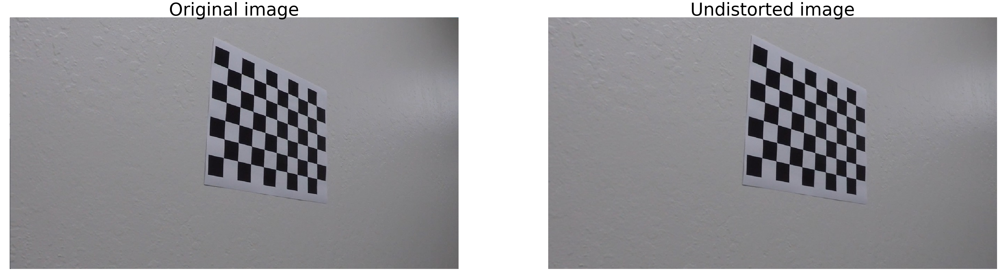

In [5]:
image = mpimg.imread(images[1])
undist = undistorted_images(image, mtx, dist)
fig, axes = plt.subplots(1,2, figsize=(60,30))
axes[0].imshow(image)
axes[0].set_title('Original image', fontsize=60)
axes[0].axis('off')
axes[1].imshow(undist)
axes[1].set_title('Undistorted image', fontsize=60)
axes[1].axis('off')
plt.show()
fig.savefig(os.path.join(out_cal_images_path, 'undistorted'+ os.path.split(images[1])[1]))

## 3. Perspective transform

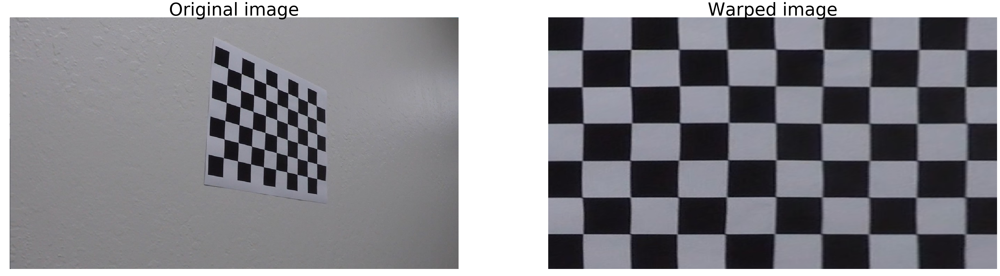

In [6]:
warped_image = warped_image(image, undist, nx=9, ny=6)
fig, axes = plt.subplots(1,2, figsize=(60,30))
axes[0].imshow(image)
axes[0].set_title('Original image', fontsize=60)
axes[0].axis('off')
axes[1].imshow(warped_image)
axes[1].set_title('Warped image', fontsize=60)
axes[1].axis('off')
plt.show()
fig.savefig(os.path.join(out_cal_images_path, 'warped'+ os.path.split(images[1])[1]))

## 4. Apply a distortion correction to raw images

In [7]:
from perspective_transform_utils import warped_test_images

In [8]:
raw_images = glob.glob('./test_images/*')

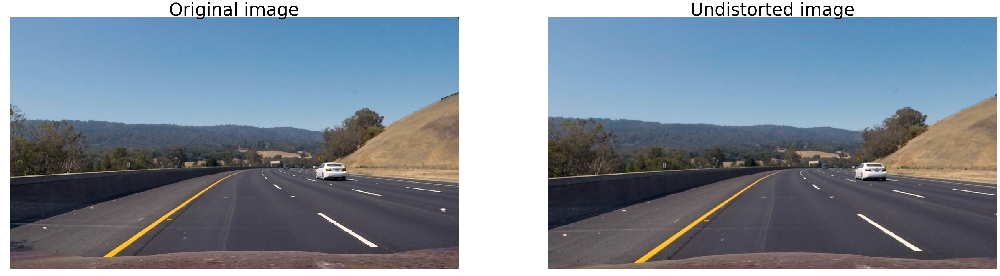

In [9]:
raw_image = mpimg.imread(raw_images[1])
undist_rawimg = undistorted_images(raw_image, mtx, dist)
fig, axes = plt.subplots(1,2, figsize=(60,30))
axes[0].imshow(raw_image)
axes[0].set_title('Original image', fontsize=60)
axes[0].axis('off')
axes[1].imshow(undist_rawimg)
axes[1].set_title('Undistorted image', fontsize=60)
axes[1].axis('off')
plt.show()
fig.savefig(os.path.join(out_cal_images_path, 'undistorted'+ os.path.split(raw_images[2])[1]))

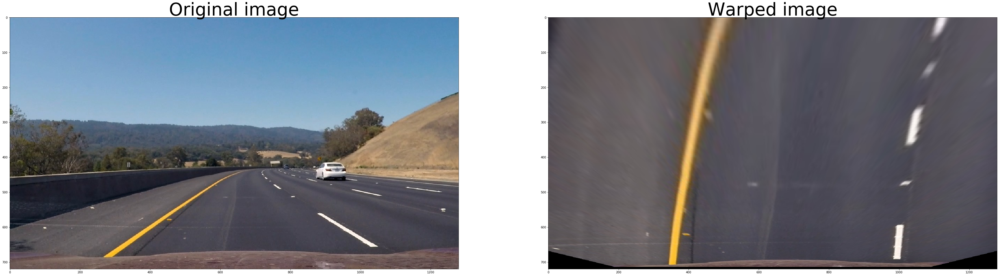

In [10]:
warped_test_image = warped_test_images(undist_rawimg, inverse=False)
fig, axes = plt.subplots(1,2, figsize=(60,30))
axes[0].imshow(raw_image)
axes[0].set_title('Original image', fontsize=60)
# axes[0].axis('off')
axes[1].imshow(warped_test_image)
axes[1].set_title('Warped image', fontsize=60)
# axes[1].axis('off')
plt.show()
fig.savefig(os.path.join(out_cal_images_path, 'warped'+ os.path.split(raw_images[2])[1]))

# Part 2: Binary image

In [11]:
from binary_utils import compare_color_space, compare_binary, abs_sobel_thresh, mag_thresh, ang_thresh, color_transform, combined_gradient_threshold, combined_color_threshold
from plot_image import plot

## Color space camparison

1. Compare RGB, HLS and HSV

In [12]:
from __future__ import print_function
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets

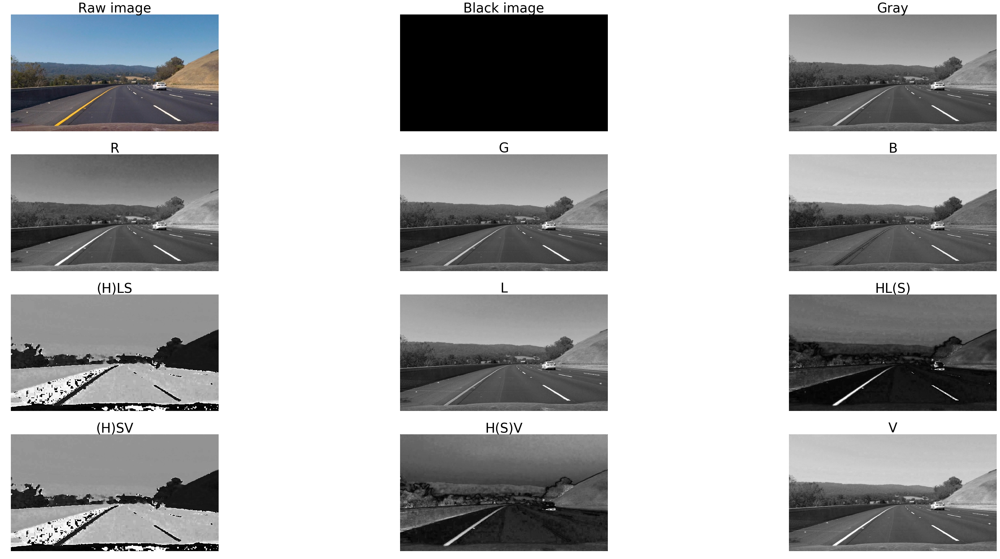

In [13]:
gray, R, G, B, H, L, S, H2, S2, V2 = compare_color_space(raw_image)
black_img = np.zeros(gray.shape,np.uint8)
store_path = os.path.join(out_cal_images_path, 'white_RGB_HLS_HSV.jpg')
img_list = [[raw_image, black_img, gray], [R, G, B], [H, L, S], [H2, S2, V2]]
titles = [['Raw image', 'Black image', 'Gray'], ['R', 'G', 'B'], ['(H)LS', 'L', 'HL(S)'], ['(H)SV', 'H(S)V', 'V']]
plot(img_list=img_list, titles=titles, row=4, column=3, figsize=(60,30), fontsize=40, cmap='gray', path=store_path)

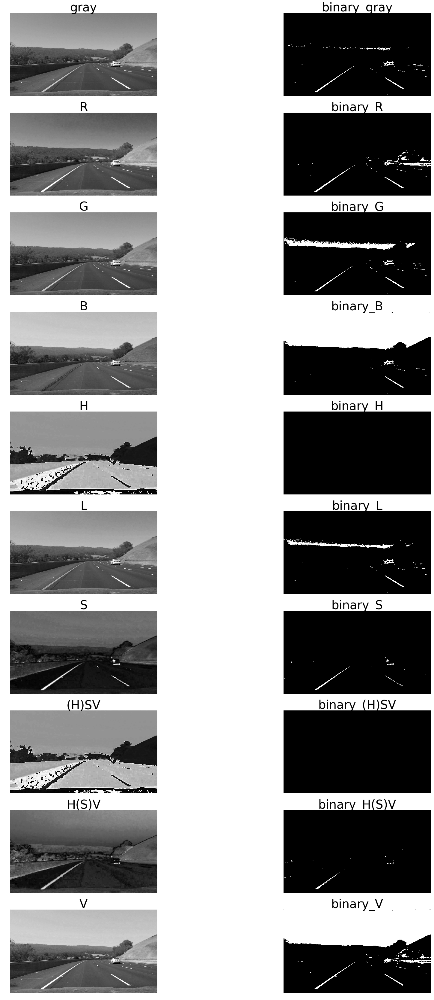

In [14]:
thresh = (180, 255)
binary_gray = compare_binary(gray, thresh)
binary_R = compare_binary(R, thresh)
binary_G = compare_binary(G, thresh)
binary_B = compare_binary(B, thresh)
binary_H = compare_binary(H, thresh)
binary_L = compare_binary(L, thresh)
binary_S = compare_binary(S, thresh)
binary_H2 = compare_binary(H2, thresh)
binary_S2 = compare_binary(S2, thresh)
binary_V = compare_binary(V2, thresh)

store_path = os.path.join(out_cal_images_path, 'compare_binary.jpg')
img_list = [[gray, binary_gray], [R, binary_R], [G, binary_G], [B, binary_B], [H, binary_H], [L, binary_L], [S, binary_S],
           [H2, binary_H2], [S2, binary_S2], [V2, binary_V]]
titles = [['gray', 'binary_gray'], ['R', 'binary_R'], ['G', 'binary_G'], ['B', 'binary_B'], ['H', 'binary_H'], ['L', 'binary_L'], ['S', 'binary_S'], ['(H)SV', 'binary_(H)SV'], ['H(S)V', 'binary_H(S)V'], ['V', 'binary_V']]
plot(img_list=img_list, titles=titles, row=10, column=2, figsize=(30,60), fontsize=40, cmap='gray', path=store_path)

2. Compare gradient, magnitude gradient, direction gradient

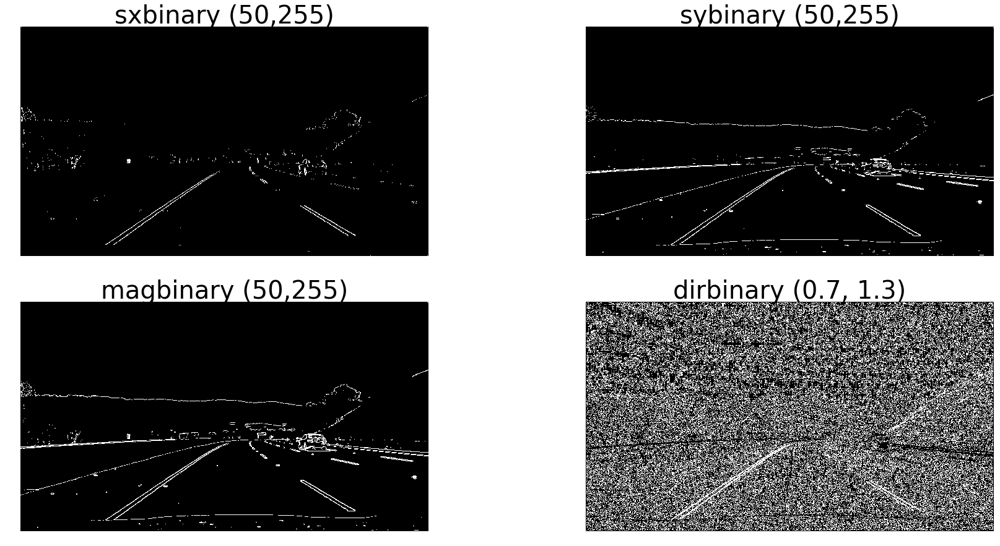

In [15]:
sxbinary = abs_sobel_thresh(img = raw_image, thresh=(50,255), orient='x', sobel_kernel=3)
sybinary = abs_sobel_thresh(img = raw_image, thresh=(50,255), orient='y', sobel_kernel=3)
magbinary = mag_thresh(img = raw_image, sobel_kernel=3, mag_thresh=(50, 255))
dirbinary = ang_thresh(img = raw_image, sobel_kernel=3, thresh=(0.7, 1.3))

store_path = os.path.join(out_cal_images_path, 'compare_gradient.jpg')
img_list = [[sxbinary, sybinary], [magbinary, dirbinary]]
titles = [['sxbinary (50,255)', 'sybinary (50,255)'], ['magbinary (50,255)', 'dirbinary (0.7, 1.3)']]
plot(img_list=img_list, titles=titles, row=2, column=2, figsize=(30,15), fontsize=40, cmap='gray', path=store_path)

3. Create color binary image and combined binary image

In [16]:
img_list = []
titles = []
for fname in raw_images:
    image = mpimg.imread(fname)
    color_binary = color_transform(img=image, s_thresh=(170, 255), sx_thresh=(20, 100), sobel_kernel=3)
    combined = combined_gradient_threshold(image, sx_thresh=(20, 100), dir_thresh=(0.7, 1.3), sobel_kernel=9)
    combined_binary = combined_color_threshold(image, s_thresh=(170, 255), combined=combined)
    s_list = [image, color_binary, combined_binary]
    title = ['Original image', 'Color binary', 'Combined binary']
    img_list.append(s_list)
    titles.append(title)

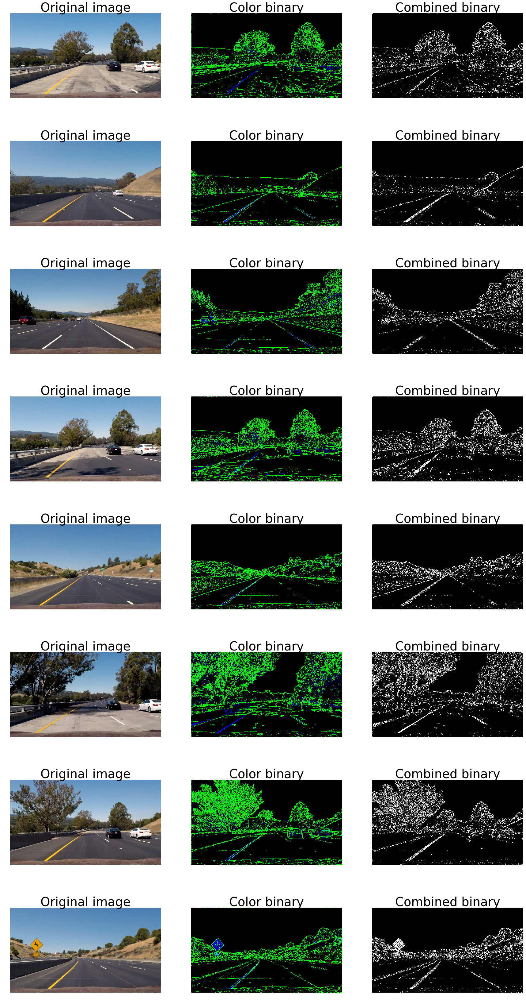

In [17]:
store_path = os.path.join(out_cal_images_path, 'totalbinary.jpg')
plot(img_list=img_list, titles=titles, row=8, column=3, figsize=(30,60), fontsize=40, cmap='gray', path=store_path)

# Part 3 - Birds-eye view

In [18]:
from perspective_transform_utils import warped_test_images, weighted_img

In [19]:
img_list = []
titles = []
for fname in raw_images:
    image = mpimg.imread(fname)
    img_size = (image.shape[1], image.shape[0])
    src = np.float32([[200, img_size[1]-10], # bottom left
                     [img_size[0]-200, img_size[1]-10], # bottom right
                     [img_size[0]/2+60, img_size[1]/2+100], # upper right
                     [img_size[0]/2-60, img_size[1]/2+100]]) # upper left
    dst = np.float32([[320, img_size[1]-10], # bl
                      [img_size[0]-320, img_size[1]-10], # br
                      [img_size[0]-320, 0], #ur
                      [320, 0]]) # ul                 
    undist = undistorted_images(image, mtx, dist)
    warped_test_image = warped_test_images(undist, inverse=False)
    cv2.line(undist, tuple(src[0]), tuple(src[1]), [255, 0, 0], 2)
    cv2.line(undist, tuple(src[1]), tuple(src[2]), [255, 0, 0], 2)
    cv2.line(undist, tuple(src[2]), tuple(src[3]), [255, 0, 0], 2)
    cv2.line(undist, tuple(src[3]), tuple(src[0]), [255, 0, 0], 2)
    cv2.line(warped_test_image, tuple(dst[0]), tuple(dst[1]), [255, 0, 0], 2)
    cv2.line(warped_test_image, tuple(dst[1]), tuple(dst[2]), [255, 0, 0], 2)
    cv2.line(warped_test_image, tuple(dst[2]), tuple(dst[3]), [255, 0, 0], 2)
    cv2.line(warped_test_image, tuple(dst[3]), tuple(dst[0]), [255, 0, 0], 2)
    s_list = [image, undist, warped_test_image]
    title = ['Original image', 'Undistorted image', 'Warped image']
    img_list.append(s_list)
    titles.append(title)


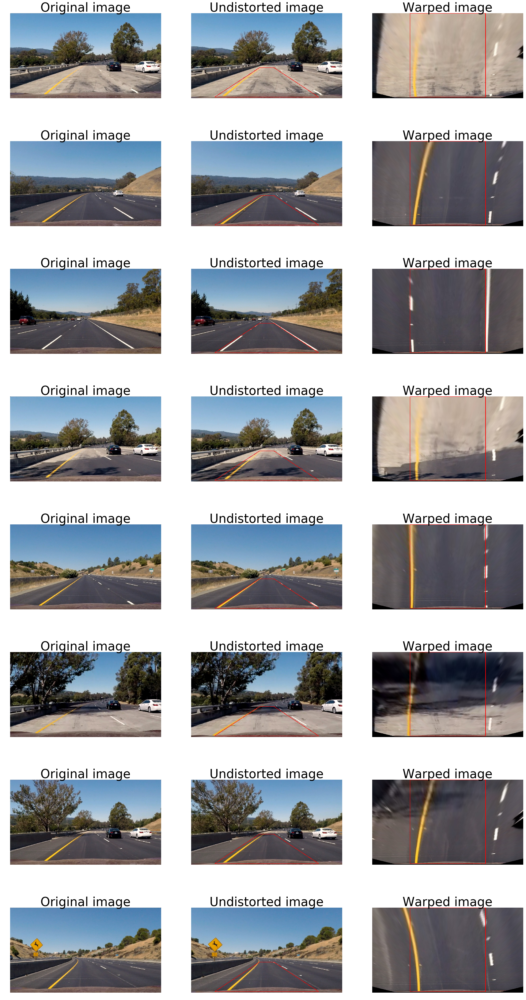

In [20]:
store_path = os.path.join(out_cal_images_path, 'totalbirdeye.jpg')
plot(img_list=img_list, titles=titles, row=8, column=3, figsize=(30,60), fontsize=40, cmap='gray', path=store_path)

Bird eye view binary

In [21]:
img_list = []
titles = []
for fname in raw_images:
    image = mpimg.imread(fname)
    undist = undistorted_images(image, mtx, dist)
    warped_test_image = warped_test_images(undist, inverse=False)
    combined1 = combined_gradient_threshold(undist, sx_thresh=(20, 100), dir_thresh=(0.7, 1.3), sobel_kernel=9)
    combined_binary1 = combined_color_threshold(undist, s_thresh=(170, 255), combined=combined1)
    combined2 = combined_gradient_threshold(warped_test_image, sx_thresh=(20, 100), dir_thresh=(0.7, 1.3), sobel_kernel=9)
    combined_binary2 = combined_color_threshold(warped_test_image, s_thresh=(170, 255), combined=combined2)
    s_list = [combined_binary1, combined_binary2]
    title = ['Undistorted binary', 'Warped binary']
    img_list.append(s_list)
    titles.append(title)

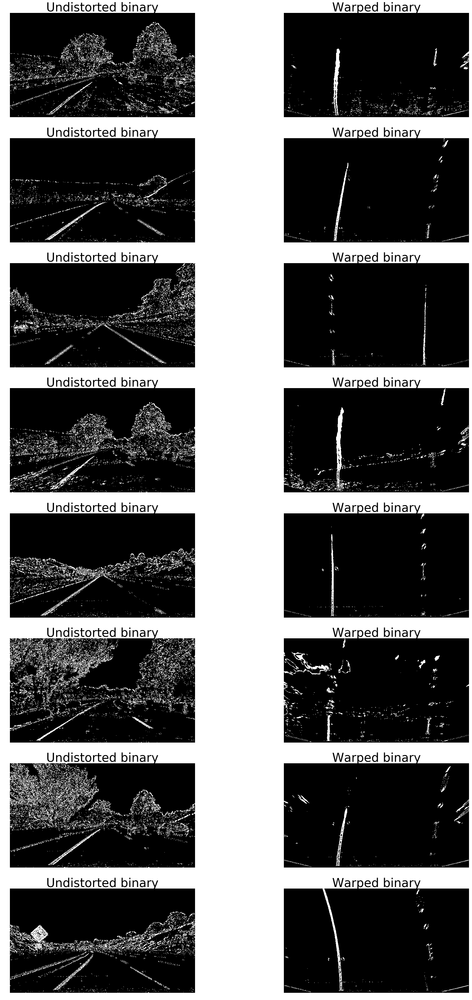

In [22]:
store_path = os.path.join(out_cal_images_path, 'birdeye_undist_warped.jpg')
plot(img_list=img_list, titles=titles, row=8, column=2, figsize=(30,60), fontsize=40, cmap='gray', path=store_path)

# Part 4 - Detect lane pixels and fit to find the lane boundary

## 1. Peaks in a Histogram

In [23]:
from lane_pixels_utils import hist, find_lane_pixels_blind, find_lane_pixels, fit_polynomial, visualization_window, visualization_outimg
from line_utils import Line

In [24]:
img_list = []
titles = []
for fname in raw_images:
    image = mpimg.imread(fname)
    undist = undistorted_images(image, mtx, dist)
    warped_test_image = warped_test_images(undist, inverse=False)
    combined = combined_gradient_threshold(warped_test_image, sx_thresh=(20, 100), dir_thresh=(0.7, 1.3), sobel_kernel=9)
    combined_binary = combined_color_threshold(warped_test_image, s_thresh=(170, 255), combined=combined)
    histogram = hist(combined_binary)
    s_list = [combined_binary, histogram, ]
    title = ['Warped binary', 'Histogram']
    img_list.append(s_list)
    titles.append(title)

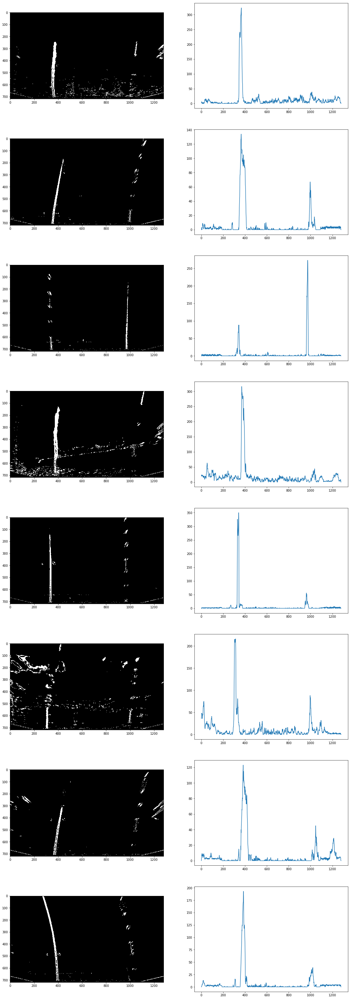

In [25]:
fig, axes = plt.subplots(8,2, figsize=(20,60))
store_path = os.path.join(out_cal_images_path, 'birdeye_histogram.jpg')
for i in range(8):
    axes[i, 0].imshow(img_list[i][0], cmap='gray') 
    axes[i, 1].plot(img_list[i][1])
fig.savefig(store_path)

## 2. Lane lines image with sliding windows

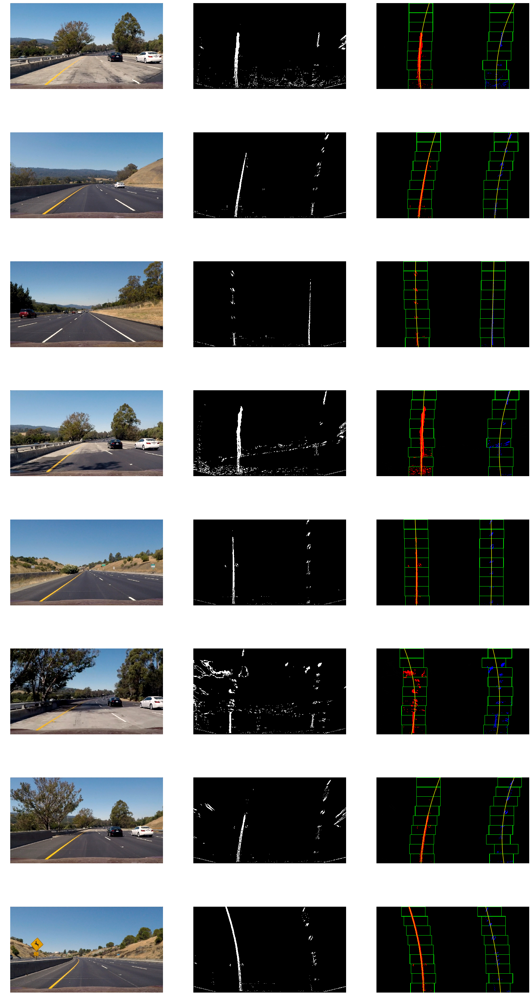

In [26]:
fig, axes = plt.subplots(8, 3, figsize=(30,60))
store_path = os.path.join(out_cal_images_path, 'binary_swindow.jpg')
left_lane_line = Line()
right_lane_line = Line()
for i, fname in enumerate(raw_images):
    image = mpimg.imread(fname)
    undist = undistorted_images(image, mtx, dist)
    warped_test_image = warped_test_images(undist, inverse=False)
    combined = combined_gradient_threshold(warped_test_image, sx_thresh=(20, 100), dir_thresh=(0.7, 1.3), sobel_kernel=9)
    combined_binary = combined_color_threshold(warped_test_image, s_thresh=(170, 255), combined=combined)
    left_lane_line, right_lane_line, out_img = find_lane_pixels_blind(combined_binary, left_lane_line, right_lane_line, nwindows=9, margin=100, minpix=50, verbose=True)
    left_lane_line, right_lane_line, ploty = fit_polynomial(left_lane_line, right_lane_line, combined_binary, thresh=50, sanity = False)
    result = visualization_window(out_img, left_lane_line, right_lane_line)
    axes[i, 0].imshow(image)
    axes[i, 0].axis('off')
    axes[i, 1].imshow(combined_binary, cmap='gray')
    axes[i, 1].axis('off')
    
    axes[i, 2].imshow(result)
    axes[i, 2].axis('off')
    axes[i, 2].plot(left_lane_line.bestx, ploty, color='yellow')
    axes[i, 2].plot(right_lane_line.bestx, ploty, color='yellow')
fig.savefig(store_path)

## 3. Lane lines image without sliding windows

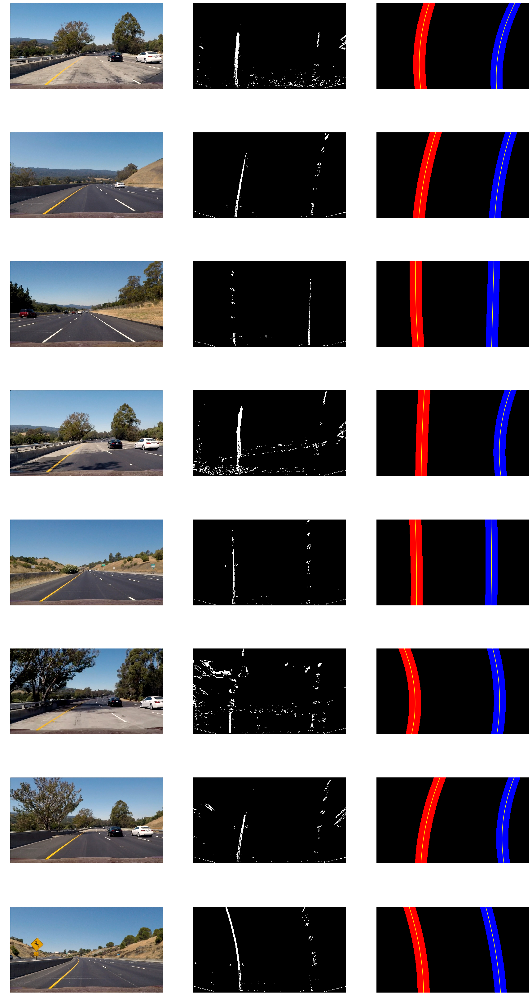

In [27]:
fig, axes = plt.subplots(8, 3, figsize=(30,60))
store_path = os.path.join(out_cal_images_path, 'binary_without_swindow.jpg')
for i, fname in enumerate(raw_images):
    image = mpimg.imread(fname)
    undist = undistorted_images(image, mtx, dist)
    warped_test_image = warped_test_images(undist, inverse=False)
    combined = combined_gradient_threshold(warped_test_image, sx_thresh=(20, 100), dir_thresh=(0.7, 1.3), sobel_kernel=9)
    combined_binary = combined_color_threshold(warped_test_image, s_thresh=(170, 255), combined=combined)
    left_lane_line, right_lane_line, out_img = find_lane_pixels_blind(combined_binary, left_lane_line, right_lane_line, nwindows=9, margin=100, minpix=50, verbose=True)
    left_lane_line, right_lane_line, ploty = fit_polynomial(left_lane_line, right_lane_line, combined_binary, thresh=50, sanity = False)
    result = visualization_outimg(combined_binary, left_lane_line, right_lane_line, ploty, margin=50, test=False)
    axes[i, 0].imshow(image)
    axes[i, 0].axis('off')
    axes[i, 1].imshow(combined_binary, cmap='gray')
    axes[i, 1].axis('off')
    
    axes[i, 2].imshow(result)
    axes[i, 2].axis('off')
    axes[i, 2].plot(left_lane_line.bestx, ploty, color='yellow')
    axes[i, 2].plot(right_lane_line.bestx, ploty, color='yellow')
fig.savefig(store_path)

# Part 5 - Determine the curvature of the lane and vehicle position with respect to center

In [28]:
from curvature_utils import measure_curvature_pixels, offset_to_center

In [29]:
for fname in raw_images:
    img_name = os.path.split(fname)[1]
    img_name = os.path.splitext(img_name)[0]
    image = mpimg.imread(fname)
    undist = undistorted_images(image, mtx, dist)
    warped_test_image = warped_test_images(undist, inverse=False)
    combined = combined_gradient_threshold(warped_test_image, sx_thresh=(20, 100), dir_thresh=(0.7, 1.3), sobel_kernel=9)
    combined_binary = combined_color_threshold(warped_test_image, s_thresh=(170, 255), combined=combined)
    left_lane_line, right_lane_line, out_img = find_lane_pixels_blind(combined_binary, left_lane_line, right_lane_line, nwindows=9, margin=100, minpix=50, verbose=True)
    left_lane_line, right_lane_line, ploty = fit_polynomial(left_lane_line, right_lane_line, combined_binary, thresh=50, sanity = False)
    left_lane_line, right_lane_line = measure_curvature_pixels(left_lane_line, right_lane_line, ploty)
    offset = offset_to_center(combined_binary,left_lane_line, right_lane_line)
    print(f"Image: {img_name}")
    print(f"Left and right radius of curvature: {left_lane_line.radius_of_curvature}m, {right_lane_line.radius_of_curvature}m")
    print(f"Offset: {offset}")

Image: test1
Left and right radius of curvature: 469.9912944928042m, 379.4125855075888m
Offset: -0.27749999999999997
Image: test3
Left and right radius of curvature: 716.1262634513982m, 609.0846076710624m
Offset: -0.24859375
Image: straight_lines2
Left and right radius of curvature: 1422.343947274277m, 589103.3963691839m
Offset: -0.23125
Image: test4
Left and right radius of curvature: 2725.842488808954m, 294769.79746871925m
Offset: -0.254375
Image: straight_lines1
Left and right radius of curvature: 3167.7921560577306m, 149408.84135887507m
Offset: -0.24859375
Image: test5
Left and right radius of curvature: 1758.036138331358m, 74954.8216878146m
Offset: -0.21390625
Image: test6
Left and right radius of curvature: 1198.267297358967m, 37673.51331794961m
Offset: -0.254375
Image: test2
Left and right radius of curvature: 949.134220179571m, 19393.71386285086m
Offset: -0.29484375


# Part 6 - Warp the detected lane boundaries back onto the original image

In [30]:
img_list = []
titles = []
for fname in raw_images:
    image = mpimg.imread(fname)
    undist = undistorted_images(image, mtx, dist)
    warped_test_image = warped_test_images(undist, inverse=False)
    combined = combined_gradient_threshold(warped_test_image, sx_thresh=(20, 100), dir_thresh=(0.7, 1.3), sobel_kernel=9)
    combined_binary = combined_color_threshold(warped_test_image, s_thresh=(170, 255), combined=combined)
    left_lane_line, right_lane_line, out_img = find_lane_pixels_blind(combined_binary, left_lane_line, right_lane_line, nwindows=9, margin=100, minpix=50, verbose=True)
    left_lane_line, right_lane_line, ploty = fit_polynomial(left_lane_line, right_lane_line, combined_binary, thresh=50, sanity = False)
    result = visualization_outimg(combined_binary, left_lane_line, right_lane_line, ploty, margin=50, test=True)
    warped_inverse = warped_test_images(result, inverse=True)
    weighted_image = weighted_img(warped_inverse, image, α=1, β=0.5, γ=0.)
    s_list = [undist, weighted_image]
    title = ['Undistorted image', 'Weighted image']
    img_list.append(s_list)
    titles.append(title)

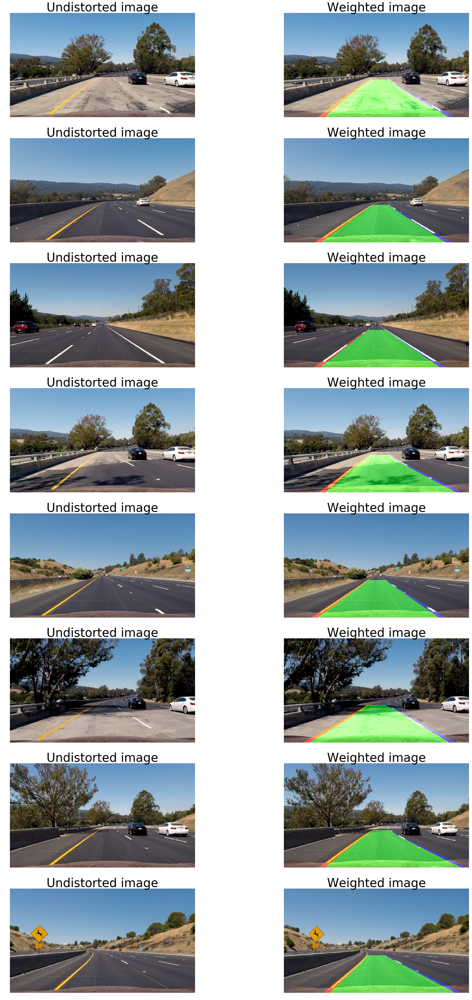

In [31]:
store_path = os.path.join(out_cal_images_path, 'weighted_img.jpg')
plot(img_list=img_list, titles=titles, row=8, column=2, figsize=(30,60), fontsize=40, cmap='gray', path=store_path)

# Part 7 - Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position

In [32]:
img_list = []
titles = []
for fname in raw_images:
    image = mpimg.imread(fname)
    undist = undistorted_images(image, mtx, dist)
    warped_test_image = warped_test_images(undist, inverse=False)
    combined = combined_gradient_threshold(warped_test_image, sx_thresh=(20, 100), dir_thresh=(0.7, 1.3), sobel_kernel=9)
    combined_binary = combined_color_threshold(warped_test_image, s_thresh=(170, 255), combined=combined)
    left_lane_line, right_lane_line, out_img = find_lane_pixels_blind(combined_binary, left_lane_line, right_lane_line, nwindows=9, margin=100, minpix=50, verbose=True)
    left_lane_line, right_lane_line, ploty = fit_polynomial(left_lane_line, right_lane_line, combined_binary, thresh=50, sanity = False)
    result = visualization_outimg(combined_binary, left_lane_line, right_lane_line, ploty, margin=50, test=True)
    warped_inverse = warped_test_images(result, inverse=True)
    weighted_image = weighted_img(warped_inverse, image, α=1, β=0.5, γ=0.)
    left_lane_line, right_lane_line, ploty = fit_polynomial(left_lane_line, right_lane_line, combined_binary)
    left_lane_line, right_lane_line = measure_curvature_pixels(left_lane_line, right_lane_line, ploty)
    offset = offset_to_center(combined_binary,left_lane_line, right_lane_line)
    mean_curvature_meter = np.mean([left_lane_line.radius_of_curvature, right_lane_line.radius_of_curvature])
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(weighted_image, 'Curvature radius: {:.02f}m'.format(mean_curvature_meter), (10, 60), font, 1.5, (255, 255, 255), 2, cv2.LINE_AA)
    cv2.putText(weighted_image, 'Offset from center: {:.02f}m'.format(offset), (10, 130), font, 1.5, (255, 255, 255), 2, cv2.LINE_AA)
    s_list = [undist, weighted_image]
    title = ['Undistorted image', 'Weighted image']
    img_list.append(s_list)
    titles.append(title)

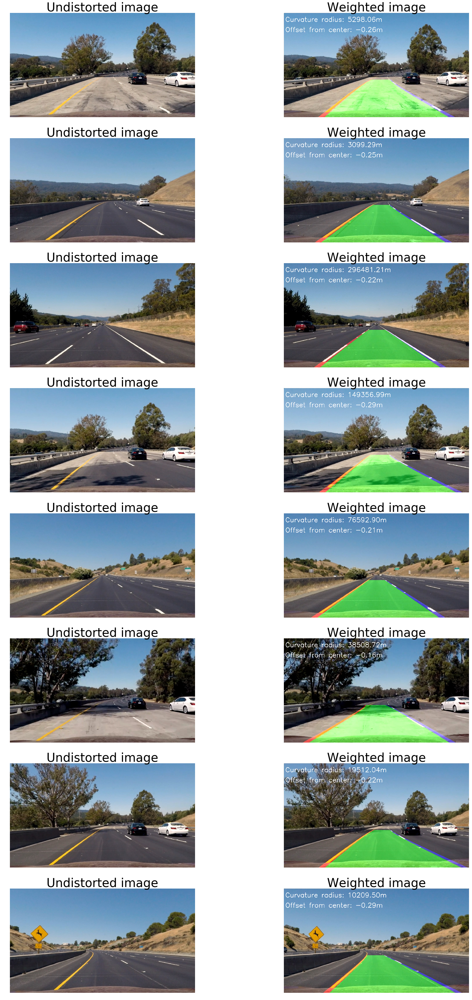

In [33]:
store_path = os.path.join(out_cal_images_path, 'weighted_img_with_ro.jpg')
plot(img_list=img_list, titles=titles, row=8, column=2, figsize=(30,60), fontsize=40, cmap='gray', path=store_path)

# Part 8 - Pipeline

In [34]:
from pipeline import pipeline
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [35]:
def process_image(image):
    # The output is a color image (3 channel) for processing video below
    # Here the final output is an image where lines are drawn on lanes

    result = pipeline(image, mtx=mtx, dist=dist, left_lane_line=left_lane_line, right_lane_line=right_lane_line,
                      nwindows=9, margin=100, minpix=100, verbose=False, test=True)

    return result

In [36]:
left_lane_line = Line()
right_lane_line = Line()
output = 'test_videos_output/project_video.mp4'
# clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4").subclip(0,5)
clip = VideoFileClip('test_videos/project_video.mp4')
white_clip = clip.fl_image(process_image) # color image
%time white_clip.write_videofile(output, audio=False)

[MoviePy] >>>> Building video test_videos_output/project_video.mp4
[MoviePy] Writing video test_videos_output/project_video.mp4


100%|█████████▉| 1260/1261 [07:21<00:00,  2.86it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_videos_output/project_video.mp4 

CPU times: user 5min 9s, sys: 2.78 s, total: 5min 12s
Wall time: 7min 24s


In [38]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(output))